In [3]:
%load_ext autoreload

%autoreload 2

In [66]:
import plotly
import plotly.express as px
from plotly.offline import download_plotlyjs, init_notebook_mode, iplot
from json import dumps
import utils
import numpy as np
import pandas as pd
plotly.offline.init_notebook_mode()


In [14]:
cdmx = utils.request_CENSUS_data_from_INEGI("CDMX")

In [81]:
# Keep only data for manzanas, not aggregated data
cdmx = cdmx[(cdmx['NOM_LOC']!='Total de la entidad') & (cdmx['NOM_LOC']!='Total del municipio') & \
        (cdmx['NOM_LOC']!='Total de la localidad urbana') & (cdmx['NOM_LOC']!='Total AGEB urbana')]
cdmx = cdmx.reset_index(drop=True)
cdmx['CVEGEO'] = cdmx['ENTIDAD'] + cdmx['MUN'] + cdmx['LOC'] + cdmx['AGEB'] + cdmx['MZA'] # Key for GeoJson file

In [106]:
cdmx_AGEB_URBANA = cdmx[cdmx['NOM_LOC']=="Total AGEB urbana"].reset_index()

In [107]:
cdmx_AGEB_URBANA.head()

,index,ENTIDAD,NOM_ENT,MUN,NOM_MUN,LOC,NOM_LOC,AGEB,MZA,POBTOT,...,VPH_TV,VPH_REFRI,VPH_LAVAD,VPH_AUTOM,VPH_PC,VPH_TELEF,VPH_CEL,VPH_INTER,geometry,CVEGEO
0,3,09,Distrito Federal,002,Azcapotzalco,0001,Total AGEB urbana,0010,000,3424,...,805,804,762,466,447,751,598,346,None,0900200010010000
1,30,09,Distrito Federal,002,Azcapotzalco,0001,Total AGEB urbana,0025,000,5912,...,1558,1520,1340,532,712,1310,1137,523,None,0900200010025000
2,76,09,Distrito Federal,002,Azcapotzalco,0001,Total AGEB urbana,003A,000,4638,...,1117,1106,996,436,525,949,821,395,None,090020001003A000
3,107,09,Distrito Federal,002,Azcapotzalco,0001,Total AGEB urbana,0044,000,5007,...,1261,1242,1125,493,603,1099,927,454,None,0900200010044000
4,152,09,Distrito Federal,002,Azcapotzalco,0001,Total AGEB urbana,0097,000,2260,...,556,552,513,282,309,518,407,259,None,0900200010097000


## Variables to construct the wealth Index ##

We follow the methodology of CONAPO (2010) to construct the marginalization index at the municipal level.

What variables do we need to replicate CONAPO's methodology? 
1. **Percentage of illiterate population aged 15 or more**<br>
    a. P15YM_AN:  Population 15-130 years old who cannot read or write <br>
    b. POB15_64:  Total population aged 15-64 years old <br>
    c. POB65_MAS: Total population ageed > 64 years old <br>
   **illiterate = P15YM_AN/(POB15_64 + POB65_MAS)** <br><br>   
2. **Percentage of population aged > 15 years old without full primary education** <br>
    a. P15PRI_IN: Population 15-130 years old who who completed 5th grade as maximum. It includes people who did not specify the grade passed in the this education level <br>
    b. P15YM_SE: Population 15-130 who do not passed any grade of schooling or that only have pre-school <br>
    c. POB65_MAS: Total population ageed > 64 years old <br>
    d. POB15_64:  Total population aged 15-64 years old <br>

    <br> **no_primary_educ = (P15PRI_IN + P15YM_SE) /(POB15_64 + POB65_MAS)** <br> <br> 
3. **Percentage of homes with no sewer system or toilet** <br>
    a. VPH_DRENAJ: Inhabited Private homes that have drainage connected to the public network, septic tank, canyon, crack, river, lake or sea. It includes the private homes for which the characteristics of the dwelling were classified, classified as a house independent, department in building, housing or room in neighborhood and housing or room in roof and to those that did not specify housing class.<br>
    b. VPH_NODREN: Inhabited Private homes that have no drainage connected to the public network, septic tank, canyon, crack, river, lake or sea. It includes the private homes for which the characteristics of the house were captured, classified as independent house, apartment in building, housing or room in neighborhood and housing or rooftop room and to which they did not specify housing class <br>
   **no_sewing = (VPH_NODREN) /(VPH_DRENAJ + VPH_NODREN)** <br> <br> 
4. **Percentage of homes with no electricity** <br>
     (CONAPO uses total number of occupants, not # of houses) <br>
    a. VPH_C_ELEC: Inhabited Private dwellings that have electricity. It includes the private homes for which the characteristics of the house were captured, classified as an independent house, apartment in building, housing or room in neighborhood and housing or rooftop room and to which they did not specify housing class.<br>
    b. VPH_S_ELEC: Inhabited Private dwellings that do not have electricity. It includes the private homes for which the characteristics of the house were captured, classified as an independent house, apartment in building, housing or room in neighborhood and housing or rooftop room and to which they did not specify housing class.<br>
    **no_electricity = (VPH_S_ELEC) /(VPH_S_ELEC + VPH_C_ELEC)** <br><br>   
5. **Percentage of homes with no piped water** <br>
     (CONAPO uses total number of occupants, not # of houses) <br>
    a. VPH_AGUADV: Private dwellings that have availability of piped water inside the house, or outside the house but within the ground. It includes the private homes for which the characteristics of the house were captured, classified as an independent house, apartment in building, housing or room in neighborhood and housing or rooftop room and to which they did not specify housing class.<br>
    b. VPH_AGUAFV: Private dwellings that do not have electricity. It includes the private homes for which the characteristics of the house were captured, classified as an independent house, apartment in building, housing or room in neighborhood and housing or rooftop room and to which they did not specify housing class.<br>
    **no_water = (VPH_AGUAFV) /(VPH_AGUADV + VPH_AGUAFV)** <br><br>
6. **Average occupants per room** <br>
    Result of dividing the number of people residing in private dwellings inhabited by the number of rooms in those homes.<br>
    **PRO_OCUP_C**<br>
    It includes the private homes for which the characteristics of the house were captured, classified as an independent house, apartment in building, housing or room in neighborhood and housing or rooftop room and to which they did not specify housing class.<br><br>
7. **Percentage of inhabited private homes with dirt floor**   <br> 
    VPH_PISOTI: Inhabited Private homes with dirt floor. It includes the private homes for which the characteristics of the house were captured, classified as independent house, apartment in building, housing or room in neighborhood and housing or rooftop room and to which they did not specify housing class<br>
    VPH_PISODT: Inhabited Private homes  with cement or firm floor, wood, mosaic or other material. It includes the private homes for which the characteristics of the house were captured, classified as independent house, apartment in building, housing or room in neighborhood and housing or rooftop room and to which they did not specify housing class <br>
    **dirt_floor = VPH_PISOTI/(VPH_PISOTI + VPH_PISODT)** <br> <br>

8. **Percentage of inhabited private homes with no fridge**   <br>

    VPH_REFRI: Inhabited private homes that have a refrigerator. It includes the private homes for which the characteristics of the house were captured, classified as an independent house, apartment in building, housing or room in neighborhood and housing or rooftop room and to which they did not specify housing class.
    TVIVPARHAB: Private dwellings inhabited of any kind: independent house, apartment in building, housing or room in neighborhood, housing or rooftop room, premises not built for room, mobile home, shelters or unspecified class. Includes private homes without occupant information.
    **no_fridge = (VIVTOT - VPH_REFRI) / VIVTOT** <br>
    
    (CONAPO uses TVIVPARHAB but there is no info available at the manzana level, but only at localidad level <br>
    
**ADDING OTHER INDICATORS**

9. **Percentage of inhabited private homes with no car** 
    VPH_AUTOM: Inhabited private homes that have a car or van. It includes the private homes for which the characteristics of the house were captured, classified as an independent house, apartment in building, housing or room in neighborhood and housing or rooftop room and to which they did not specify housing class.
    TVIVPARHAB: Inhabited private homesof any kind: independent house, apartment in building, housing or room in neighborhood, housing or rooftop room, premises not built for room, mobile home, shelters or unspecified class. Includes private homes without occupant information. <br>
    **no_car = (VIVTOT - VPH_AUTOM) / VIVTOT** <br><br>
10. **Percentage of inhabited private homes with no internet** 
    VPH_INTER: Inhabited private homes that have internet service. It includes the private homes for which the characteristics of the house were captured, classified as an independent house, apartment in building, housing or room in neighborhood and housing or rooftop room and to which they did not specify housing class.
    TVIVPARHAB: Inhabited private homes of any kind: independent house, apartment in building, housing or room in neighborhood, housing or rooftop room, premises not built for room, mobile home, shelters or unspecified class. Includes private homes without occupant information.<br>
    **no_internet = (VIVTOT - VPH_INTER) / VIVTOT**<br><br>

11. **Percentage of inhabited private homes with no washing machine** 
    VPH_LAVAD: Inhabited private homes that have internet service. It includes the private homes for which the characteristics of the house were captured, classified as an independent house, apartment in building, housing or room in neighborhood and housing or rooftop room and to which they did not specify housing class.
    TVIVPARHAB: Inhabited private homes of any kind: independent house, apartment in building, housing or room in neighborhood, housing or rooftop room, premises not built for room, mobile home, shelters or unspecified class. Includes private homes without occupant information.<br>
    **no_washingmachine = (VIVTOT - VPH_LAVAD) / VIVTOT**<br><br>
    
12. **Percentage of indigenous population** % people who form census homes where the household's head  or his/her spouse speak an indigenous language
    PHOG_IND: Total population who form census homes where the household's head  or his/her spouse speak an indigenous language<br>
    POBTOT: Total Population by geographic unit<br>
    **indigenous_pop = (PHOG_IND) / POBTOT**



In [95]:
# Variables we want to keep to construct the wealth index
vars_to_keep = ['ENTIDAD','NOM_ENT','MUN','NOM_MUN','LOC','NOM_LOC','AGEB','MZA','POBTOT',
                'POBMAS','POBFEM', 'geometry','CVEGEO',
                'P15YM_AN', 'P15PRI_IN', 'P15YM_SE', 'POB15_64', 'POB65_MAS',
                'VPH_DRENAJ', 'VPH_NODREN', 'VPH_S_ELEC', 'VPH_C_ELEC', 'VPH_AGUADV',
                'VPH_AGUAFV', 'PRO_OCUP_C', 'VPH_PISOTI','VPH_PISODT', 'VPH_REFRI',
                 'VPH_AUTOM', 'VPH_INTER', 'VIVTOT', 'VPH_LAVAD', 'PHOG_IND']
wealth_index_vars = ['illiterate', 'no_primary_educ', 'no_sewing', 'no_electricity' , 'no_water', 'dirt_floor',
                    'no_fridge', 'no_car', 'no_internet', 'overcrowded', 'indigenous_pop','no_washingmachine' ]

In [108]:
cdmx_AGEB_URBANA = cdmx_AGEB_URBANA[vars_to_keep]

In [109]:
missing_val_CDMX = utils.count_missing_manzanas(cdmx_AGEB_URBANA)
missing_val_CDMX

,missing,n/a
ENTIDAD,0.00,0.0
NOM_ENT,0.00,0.0
MUN,0.00,0.0
NOM_MUN,0.00,0.0
LOC,0.00,0.0
NOM_LOC,0.00,0.0
AGEB,0.00,0.0
MZA,0.00,0.0
POBTOT,0.00,0.0
POBMAS,0.12,0.0


In [110]:
vars_to_impute = []
for i, r in (missing_val_CDMX[missing_val_CDMX['missing']>0]).iterrows():
    vars_to_impute.append(i)

In [111]:
vars_to_impute

['POBMAS',
 'P15YM_AN',
 'P15PRI_IN',
 'P15YM_SE',
 'POB15_64',
 'POB65_MAS',
 'VPH_DRENAJ',
 'VPH_NODREN',
 'VPH_S_ELEC',
 'VPH_C_ELEC',
 'VPH_AGUADV',
 'VPH_AGUAFV',
 'VPH_PISOTI',
 'VPH_PISODT',
 'VPH_REFRI',
 'VPH_AUTOM',
 'VPH_INTER',
 'VPH_LAVAD',
 'PHOG_IND']

In [127]:
knn_imputed = utils.impute_values (df = cdmx_AGEB_URBANA, imp_strategy = "knn", neighbors = 10, numeric_vars = vars_to_impute)

In [113]:
missing_val_CDMX = utils.count_missing_manzanas(imputed_df)
missing_val_CDMX

,missing,n/a
index,0.0,0.0
ENTIDAD,0.0,0.0
NOM_MUN,0.0,0.0
POBFEM,0.0,0.0
POBTOT,0.0,0.0
NOM_LOC,0.0,0.0
MUN,0.0,0.0
PRO_OCUP_C,0.0,0.0
NOM_ENT,0.0,0.0
VIVTOT,0.0,0.0


In [134]:
cdmx_AGEB_URBANA.head()

,ENTIDAD,NOM_ENT,MUN,NOM_MUN,LOC,NOM_LOC,AGEB,MZA,POBTOT,POBMAS,...,VPH_AGUAFV,PRO_OCUP_C,VPH_PISOTI,VPH_PISODT,VPH_REFRI,VPH_AUTOM,VPH_INTER,VIVTOT,VPH_LAVAD,PHOG_IND
0,09,Distrito Federal,002,Azcapotzalco,0001,Total AGEB urbana,0010,000,3424,1600.0,...,NaN,0.83,5.0,797.0,804.0,466.0,346.0,879,762.0,23.0
1,09,Distrito Federal,002,Azcapotzalco,0001,Total AGEB urbana,0025,000,5912,2819.0,...,0.0,0.89,0.0,1556.0,1520.0,532.0,523.0,1709,1340.0,80.0
2,09,Distrito Federal,002,Azcapotzalco,0001,Total AGEB urbana,003A,000,4638,2249.0,...,NaN,0.94,0.0,1085.0,1106.0,436.0,395.0,1248,996.0,52.0
3,09,Distrito Federal,002,Azcapotzalco,0001,Total AGEB urbana,0044,000,5007,2316.0,...,NaN,0.80,NaN,1253.0,1242.0,493.0,454.0,1426,1125.0,37.0
4,09,Distrito Federal,002,Azcapotzalco,0001,Total AGEB urbana,0097,000,2260,1076.0,...,0.0,0.71,NaN,553.0,552.0,282.0,259.0,608,513.0,36.0


In [133]:
# We don't have nulls now but there are many manzanas with zero population (around 2800), which geometry is null too. This ios about 4.4% of total manzanas
# The rest of null values correspond to rows that does have some non-null cells, but reports 0 households
knn_imputed.head()

,ENTIDAD,NOM_MUN,POBFEM,POBTOT,NOM_LOC,MUN,PRO_OCUP_C,NOM_ENT,VIVTOT,AGEB,...,VPH_C_ELEC,VPH_AGUADV,VPH_AGUAFV,VPH_PISOTI,VPH_PISODT,VPH_REFRI,VPH_AUTOM,VPH_INTER,VPH_LAVAD,PHOG_IND
0,09,Azcapotzalco,1824,3424,Total AGEB urbana,002,0.83,Distrito Federal,879,0010,...,811.0,809.0,11.425595,5.000000,797.0,804.0,466.0,346.0,762.0,23.0
1,09,Azcapotzalco,3093,5912,Total AGEB urbana,002,0.89,Distrito Federal,1709,0025,...,1562.0,1560.0,0.000000,0.000000,1556.0,1520.0,532.0,523.0,1340.0,80.0
2,09,Azcapotzalco,2389,4638,Total AGEB urbana,002,0.94,Distrito Federal,1248,003A,...,1121.0,1120.0,15.689020,0.000000,1085.0,1106.0,436.0,395.0,996.0,52.0
3,09,Azcapotzalco,2691,5007,Total AGEB urbana,002,0.80,Distrito Federal,1426,0044,...,1268.0,1265.0,16.443693,11.236207,1253.0,1242.0,493.0,454.0,1125.0,37.0
4,09,Azcapotzalco,1184,2260,Total AGEB urbana,002,0.71,Distrito Federal,608,0097,...,558.0,557.0,0.000000,7.322460,553.0,552.0,282.0,259.0,513.0,36.0


In [129]:
mean_imputed = utils.impute_values (df = cdmx_AGEB_URBANA, neighbors = 5, imp_strategy = "mean", numeric_vars = vars_to_impute)

In [130]:
mean_imputed.head()

,ENTIDAD,NOM_MUN,POBFEM,POBTOT,NOM_LOC,MUN,PRO_OCUP_C,NOM_ENT,VIVTOT,AGEB,...,VPH_C_ELEC,VPH_AGUADV,VPH_AGUAFV,VPH_PISOTI,VPH_PISODT,VPH_REFRI,VPH_AUTOM,VPH_INTER,VPH_LAVAD,PHOG_IND
0,09,Azcapotzalco,1824,3424,Total AGEB urbana,002,0.83,Distrito Federal,879,0010,...,811.0,809.0,30.098458,5.000000,797.0,804.0,466.0,346.0,762.0,23.0
1,09,Azcapotzalco,3093,5912,Total AGEB urbana,002,0.89,Distrito Federal,1709,0025,...,1562.0,1560.0,0.000000,0.000000,1556.0,1520.0,532.0,523.0,1340.0,80.0
2,09,Azcapotzalco,2389,4638,Total AGEB urbana,002,0.94,Distrito Federal,1248,003A,...,1121.0,1120.0,30.098458,0.000000,1085.0,1106.0,436.0,395.0,996.0,52.0
3,09,Azcapotzalco,2691,5007,Total AGEB urbana,002,0.80,Distrito Federal,1426,0044,...,1268.0,1265.0,30.098458,11.445281,1253.0,1242.0,493.0,454.0,1125.0,37.0
4,09,Azcapotzalco,1184,2260,Total AGEB urbana,002,0.71,Distrito Federal,608,0097,...,558.0,557.0,0.000000,11.445281,553.0,552.0,282.0,259.0,513.0,36.0


In [179]:
# #Perhaps I should average by pop/manzana
# dict_of_aggregation={}
# for var in vars_to_impute:
#     if var!="PRO_OCUP_C":
#         dict_of_aggregation[var]="sum"
#     else:
#         dict_of_aggregation[var] = "mean"

In [180]:
# df_mean_imputed = df_mean_imputed.groupby(
#    ['NOM_LOC','ENTIDAD', "MUN",'LOC', 'AGEB']
# ).agg(
#     dict_of_aggregation
# ).reset_index()

In [ ]:
def add_vars_wealth_index(df):

    '''
    Computes the variables that will be used for constructing the wealth index
    Inputs:
        df- DataFrame
    Returns:
        Dataframe
    '''

    as_percent = 100

    df['illiterate'] = df['P15YM_AN']/(df['POB15_64'] + df['POB65_MAS']) * as_percent
    df['no_primary_educ'] = (df['P15PRI_IN'] + df['P15YM_SE']) /(df['POB15_64'] + df['POB65_MAS']) * as_percent
    df['no_sewing'] = (df['VPH_NODREN']) /(df['VPH_DRENAJ'] + df['VPH_NODREN']) * as_percent
    df['no_electricity'] = (df['VPH_S_ELEC']) /(df['VPH_S_ELEC'] + df['VPH_C_ELEC']) * as_percent
    df['no_water'] = (df['VPH_AGUAFV']) /(df['VPH_AGUADV'] + df['VPH_AGUAFV']) * as_percent
    df['dirt_floor'] = df['VPH_PISOTI']/(df['VPH_PISOTI'] + df['VPH_PISODT']) * as_percent
    df['no_fridge'] = (df['VIVTOT'] - df['VPH_REFRI']) / df['VIVTOT'] * as_percent
    df['no_car'] = (df['VIVTOT'] - df['VPH_AUTOM']) / df['VIVTOT'] * as_percent
    df['no_internet'] = (df['VIVTOT'] - df['VPH_INTER']) / df['VIVTOT'] * as_percent
    df['overcrowded'] = df['PRO_OCUP_C']
    
    return df

In [182]:
knn_imputed = add_vars_wealth_index(df_mean_imputed)

In [183]:
df_mean_imputed.columns

Index(['NOM_LOC', 'ENTIDAD', 'MUN', 'LOC', 'AGEB', 'POBTOT', 'POBMAS',
       'POBFEM', 'P15YM_AN', 'POB15_64', 'POB65_MAS', 'P15PRI_IN', 'P15YM_SE',
       'VPH_NODREN', 'VPH_DRENAJ', 'VPH_S_ELEC', 'VPH_C_ELEC', 'VPH_AGUADV',
       'VPH_AGUAFV', 'PRO_OCUP_C', 'VPH_PISOTI', 'VPH_PISODT', 'VPH_REFRI',
       'VPH_AUTOM', 'VPH_INTER', 'VIVTOT', 'illiterate', 'no_primary_educ',
       'no_sewing', 'no_electricity', 'no_water', 'dirt_floor', 'no_fridge',
       'no_car', 'no_internet', 'overcrowded'],
      dtype='object')

In [184]:
df_mean_imputed.isnull().sum()

NOM_LOC             0
ENTIDAD             0
MUN                 0
LOC                 0
AGEB                0
POBTOT              0
POBMAS              0
POBFEM              0
P15YM_AN            0
POB15_64            0
POB65_MAS           0
P15PRI_IN           0
P15YM_SE            0
VPH_NODREN          0
VPH_DRENAJ          0
VPH_S_ELEC          0
VPH_C_ELEC          0
VPH_AGUADV          0
VPH_AGUAFV          0
PRO_OCUP_C          0
VPH_PISOTI          0
VPH_PISODT          0
VPH_REFRI           0
VPH_AUTOM           0
VPH_INTER           0
VIVTOT              0
illiterate         21
no_primary_educ    21
no_sewing          25
no_electricity     25
no_water           25
dirt_floor         25
no_fridge          22
no_car             22
no_internet        22
overcrowded         0
dtype: int64

In [185]:
wealth_index_vars

['illiterate',
 'no_primary_educ',
 'no_sewing',
 'no_electricity',
 'no_water',
 'dirt_floor',
 'no_fridge',
 'no_car',
 'no_internet',
 'overcrowded']

In [186]:
# Keep manzanas with no missing values
df_no_missings = df_mean_imputed.query(utils.build_query_for_nulls(wealth_index_vars), engine = 'python')

In [187]:
df_no_missings.isnull().sum()

NOM_LOC            0
ENTIDAD            0
MUN                0
LOC                0
AGEB               0
POBTOT             0
POBMAS             0
POBFEM             0
P15YM_AN           0
POB15_64           0
POB65_MAS          0
P15PRI_IN          0
P15YM_SE           0
VPH_NODREN         0
VPH_DRENAJ         0
VPH_S_ELEC         0
VPH_C_ELEC         0
VPH_AGUADV         0
VPH_AGUAFV         0
PRO_OCUP_C         0
VPH_PISOTI         0
VPH_PISODT         0
VPH_REFRI          0
VPH_AUTOM          0
VPH_INTER          0
VIVTOT             0
illiterate         0
no_primary_educ    0
no_sewing          0
no_electricity     0
no_water           0
dirt_floor         0
no_fridge          0
no_car             0
no_internet        0
overcrowded        0
dtype: int64

In [188]:
df_no_missings.head()

,NOM_LOC,ENTIDAD,MUN,LOC,AGEB,POBTOT,POBMAS,POBFEM,P15YM_AN,POB15_64,...,illiterate,no_primary_educ,no_sewing,no_electricity,no_water,dirt_floor,no_fridge,no_car,no_internet,overcrowded
0,Azcapotzalco,09,002,0001,0010,3424.0,1799.921602,2045.875957,49.775864,2436.896811,...,1.599610,8.261537,0.028463,0.001699,0.353813,0.177532,-3.157107,40.493630,54.971201,0.767039
1,Azcapotzalco,09,002,0001,0025,5912.0,3016.921602,3310.875957,111.087777,4424.896811,...,2.193746,11.158922,0.011752,0.000937,0.146336,0.041489,5.046754,65.590346,65.687292,0.844067
2,Azcapotzalco,09,002,0001,003A,4638.0,2316.307201,2463.625319,97.391851,3044.298937,...,2.615307,12.894187,0.005658,0.000452,0.070421,0.020548,8.633788,63.540038,67.019147,0.916922
3,Azcapotzalco,09,002,0001,0044,5007.0,2449.614401,2836.250638,92.703765,3430.597874,...,2.248000,10.793551,0.009784,0.000779,0.182537,0.069469,8.099534,59.109281,63.716396,0.752621
4,Azcapotzalco,09,002,0001,0097,2260.0,1204.614401,1323.250638,48.623826,1672.597874,...,2.374403,9.068906,0.020851,0.001658,0.258990,0.147423,-1.727080,47.855155,51.940445,0.602970


In [ ]:
# def construct_index(df, wealth_index_vars):
    
#     df_no_missings = df.query(build_query_for_nulls(wealth_index_vars), engine = 'python')
#     X = df_no_missings[wealth_index_vars].to_numpy()
#     normalized_X = preprocessing.normalize(X)
#     pca = PCA(n_components = 1)
#     pca = pca.fit_transform(X)
#     principalDf = pd.DataFrame(data = pca, columns = ['pca_1', ])
#     rv = df_no_missings.merge(principalDf, left_index=True, right_index = True)
    
#     min_pca1 =  pca.min() # Index 0-1
#     max_pca1 = pca.max()
#     difference = max_pca1 - min_pca1
#     rv['index_01'] = (rv['pca_1'] - min_pca1)/difference
#     return rv

In [189]:
df_with_index = utils.construct_index(df_mean_imputed, wealth_index_vars)

In [ ]:
def request_shp_data_from_INEGI(state, shapefile, geojson_name):
    '''
    It makes a request to download a zipfile containing a .dbf file, downloads and extracts the dbf, and
    creates a pandas dataframe

    Inputs:

        state (string): Name of the state to create the dataframe with. Valid values are:
                        CDMX- Mexico City
                        OAXACA- Oaxaca State
                        MORELOS- Morelos state
    Returns:

        dataframe of the selected state
    '''
    if state == "CDMX":
        state_code = '09_ciudaddemexico'
    if state == "OAXACA":
        state_code = '20_oaxaca'
    if state == "MORELOS":
        state_code = '17_morelos'
    shp_URL = 'http://internet.contenidos.inegi.org.mx/contenidos/productos/prod_serv/contenidos/espanol/bvinegi/productos/geografia/marcogeo/889463776079/{}.zip'.format(state_code)
    req = requests.get(shp_URL)
    try:
        file = zipfile.ZipFile(io.BytesIO(req.content))
        file.extractall()
    except:
        print("request error")
        pass
    state_code_number = state_code[:2]
    
    if shapefile == "manzanas":
        path_shape_manzanas = "./wealth_index/Data/{}/{}m.shp".format(state_code, state_code_number) # Change your local path here
    
    try:
        geop = gpd.read_file(path_shape_manzanas, encoding='windows-1252')
    
    # #Now project coordinates to EPSG 4326:

        geop['geometry'] = geop['geometry'].to_crs(epsg=4326)
    
        geop.to_file(geojson_name, driver="GeoJSON")
    

        data.to_file(geojson_name, driver="GeoJSON")
        with open(geojson_name, 'r') as f:
            geojson_file = json.load(f)
    except:
        print("directory error")
    
    return geop, geojson_file


In [144]:
def convert_transform_shp (path, name_geojson):
    
    '''
    09a- AGEB
    09ar - Rural Agebs
    09cd - localidad rural
    09e - streets (lines)
    '''
    data = gpd.read_file(path, encoding='windows-1252' )
    data['geometry'] = data['geometry'].to_crs(epsg=4326)
    data.to_file(name_geojson, driver="GeoJSON")
    with open(name_geojson, 'r') as f:
        json_file = json.load(f)
    return json_file, data

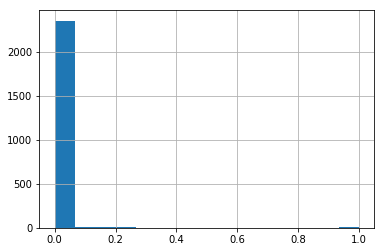

In [141]:
df_with_index['index_01'].hist(bins=15)

In [158]:
js,geop = convert_transform_shp('./wealth_index/Data/09_ciudaddemexico/conjunto_de_datos/09a.shp', 'testing.json')

/Users/aleistermontfort/anaconda3/lib/python3.7/site-packages/pyproj/crs.py:77: FutureWarning:

'+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.



In [211]:
dfjs, dfgeop = convert_transform_shp('./wealth_index/Data/09_ciudaddemexico/conjunto_de_datos/09ent.shp', 'testing.json')

/Users/aleistermontfort/anaconda3/lib/python3.7/site-packages/pyproj/crs.py:77: FutureWarning:

'+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.



In [212]:
dfgeop

,CVEGEO,CVE_ENT,NOMGEO,geometry
0,09,09,Ciudad de México,"POLYGON ((-99.11124 19.56150, -99.11485 19.557..."


In [160]:
js

{'type': 'FeatureCollection',
 'features': [{'type': 'Feature',
   'properties': {'CVEGEO': '0900200010148',
    'CVE_ENT': '09',
    'CVE_MUN': '002',
    'CVE_LOC': '0001',
    'CVE_AGEB': '0148'},
   'geometry': {'type': 'Polygon',
    'coordinates': [[[-99.20697543022209, 19.500857890169815],
      [-99.20673481394498, 19.5007792964453],
      [-99.20606870993426, 19.500561719991527],
      [-99.20624525964675, 19.499058879786308],
      [-99.20633882047542, 19.49862638004689],
      [-99.20640294041644, 19.498178310085056],
      [-99.2065281703877, 19.49730348991096],
      [-99.20662468027578, 19.496377140056076],
      [-99.20662028008779, 19.496312119882592],
      [-99.20668203008677, 19.49593248041826],
      [-99.2067738803608, 19.49498849005171],
      [-99.20683734981517, 19.49432222959759],
      [-99.20683255030423, 19.494278650283427],
      [-99.20802632034581, 19.494620860426128],
      [-99.20825088992179, 19.493856289638792],
      [-99.21023537026699, 19.494422770

In [190]:
df_with_index.head()

,NOM_LOC,ENTIDAD,MUN,LOC,AGEB,POBTOT,POBMAS,POBFEM,P15YM_AN,POB15_64,...,no_sewing,no_electricity,no_water,dirt_floor,no_fridge,no_car,no_internet,overcrowded,pca_1,index_01
0,Azcapotzalco,09,002,0001,0010,3424.0,1799.921602,2045.875957,49.775864,2436.896811,...,0.028463,0.001699,0.353813,0.177532,-3.157107,40.493630,54.971201,0.767039,4.195512,0.029368
1,Azcapotzalco,09,002,0001,0025,5912.0,3016.921602,3310.875957,111.087777,4424.896811,...,0.011752,0.000937,0.146336,0.041489,5.046754,65.590346,65.687292,0.844067,-17.773405,0.024300
2,Azcapotzalco,09,002,0001,003A,4638.0,2316.307201,2463.625319,97.391851,3044.298937,...,0.005658,0.000452,0.070421,0.020548,8.633788,63.540038,67.019147,0.916922,-20.272931,0.023724
3,Azcapotzalco,09,002,0001,0044,5007.0,2449.614401,2836.250638,92.703765,3430.597874,...,0.009784,0.000779,0.182537,0.069469,8.099534,59.109281,63.716396,0.752621,-16.576621,0.024576
4,Azcapotzalco,09,002,0001,0097,2260.0,1204.614401,1323.250638,48.623826,1672.597874,...,0.020851,0.001658,0.258990,0.147423,-1.727080,47.855155,51.940445,0.602970,0.960527,0.028621


In [191]:
df_with_index['CVEGEO'] = df_with_index['ENTIDAD'] + df_with_index['MUN'] + df_with_index['LOC'] + df_with_index['AGEB']

In [200]:
'0900200010148' in list(df_with_index['CVEGEO'])


True

In [231]:
dfjs

{'type': 'FeatureCollection',
 'features': [{'type': 'Feature',
   'properties': {'CVEGEO': '09',
    'CVE_ENT': '09',
    'NOMGEO': 'Ciudad de México'},
   'geometry': {'type': 'Polygon',
    'coordinates': [[[-99.11124113968344, 19.561497769909362],
      [-99.11485294981964, 19.55759555008847],
      [-99.11571862956919, 19.55666026034979],
      [-99.1156850897912, 19.55575571027552],
      [-99.11562145994795, 19.55403962017778],
      [-99.11848011957242, 19.552185219714392],
      [-99.12037348995757, 19.549923180052442],
      [-99.12043631956824, 19.549848120082288],
      [-99.12103574012107, 19.549131949697895],
      [-99.1212176199764, 19.548696319888194],
      [-99.12130971967265, 19.548475679889545],
      [-99.12146297000984, 19.548108620345264],
      [-99.12163373991449, 19.54769954966915],
      [-99.12174688045296, 19.547428549574647],
      [-99.12188256976313, 19.547103510366778],
      [-99.12197874960339, 19.546873110054527],
      [-99.12215348991225, 19.54654

In [ ]:
def create_choropleth(df, geojson, location_key, variable, colorscale, color_range, center, label_text, save_name):
    
    fig = px.choropleth_mapbox(df_with_index, geojson=js, locations='CVEGEO', color='no_internet',
                           color_continuous_scale="Viridis",
                           range_color=(0, 100),
                           featureidkey="properties.CVEGEO",
                           mapbox_style="carto-positron",
                           zoom=10, center = {"lat": 19.432608, "lon": -99.133209},
                           opacity=0.4,
                           labels={'index_01':'marginalization index'}
                          )
    fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
    fig.update_layout(
        title_text='Spatial Distribution of Marginalization Index',

    )
    fig2 = px.choropleth_mapbox()

    # fig.update_geos(
    #     scope="south america",
    #     showcountries=True, countrycolor="Black",
    #     showsubunits=True, subunitcolor="Black"
    # )
    fig.update_layout(mapbox_style="open-street-map")


    fig.show()
    

In [241]:
fig = px.choropleth_mapbox(df_with_index, geojson=js, locations='CVEGEO', color='no_internet',
                           color_continuous_scale="Viridis",
                           range_color=(0, 100),
                           featureidkey="properties.CVEGEO",
                           mapbox_style="carto-positron",
                           zoom=10, center = {"lat": 19.432608, "lon": -99.133209},
                           opacity=0.4,
                           labels={'index_01':'marginalization index'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.update_layout(
    title_text='Spatial Distribution of Marginalization Index',
    
)

fig.update_geos(
    visible=False, resolution=50, scope="north america",
    showcountries=True, countrycolor="Black",
    showsubunits=True, subunitcolor="Blue"
)
#fig.update_layout(mapbox_style="open-street-map")

fig.update_layout(
    mapbox = { 
        'style': "stamen-terrain",
        'center': {"lat": 19.432608, "lon": -99.133209},
        'zoom': 10},
    showlegend = False)

fig.show()
fig.write_html("./one_map.html")

In [ ]:
pk.eyJ1IjoiYWxlaXN0ZXJtIiwiYSI6ImNrNjVjMnFiNjA2eGgzbXF3a2V1dmN3eGUifQ.zNzPm9NqQKFDksXdgU-eeA

In [ ]:
import requests
import zipfile
import io

In [ ]:
# req = requests.get(shp_URL)
# file = zipfile.ZipFile(io.BytesIO(req.content))
# file.extractall()
# state_code_number = state_code[:2]

In [ ]:
# file = zipfile.ZipFile(io.BytesIO(req.content))


In [ ]:
# geopd_cdmx, geogson_file_cdmx = request_shp_data_from_INEGI('CDMX', "manzanas", "cdmx_geojson")

In [44]:
def create_geojson_from_shp (path, name):
    
    reader = shapefile.Reader(path, encoding='windows-1252')
    fields = reader.fields[1:]
    field_names = [field[0] for field in fields]
    buffer = []
    for sr in reader.shapeRecords():
        atr = dict(zip(field_names, sr.record))
        geom = sr.shape.__geo_interface__
        buffer.append(dict(type="Feature", geometry=geom, properties=atr)) 

    # # write the GeoJSON file

    geojson = open(name, "w")
    geojson.write(dumps({"type": "FeatureCollection", "features": buffer}, indent=2) + "\n")
    geojson.close()
    with open(name, 'r') as f:
        geojsonfile = json.load(f)
    return geojsonfile

In [ ]:
# Generate data on commute times.
index = a['index_01']

index.plot.hist(grid=True, bins=40, rwidth=0.9,
                   color='#607c8e')
plt.title('Wealth Index Distribution')
plt.xlabel('Index Value')
plt.ylabel('Frequency')
plt.grid(axis='y', alpha=0.75)

In [ ]:
json_cdmx = create_geojson_from_shp()

In [ ]:
path_shape_manzanas = "./wealth_index/Data/DF_shapes/df_manzanas.shp"

In [ ]:
# read the shapefile
reader = shapefile.Reader(path_shape_manzanas)
fields = reader.fields[1:]
field_names = [field[0] for field in fields]
buffer = []
for sr in reader.shapeRecords():
    atr = dict(zip(field_names, sr.record))
    geom = sr.shape.__geo_interface__
    buffer.append(dict(type="Feature", geometry=geom, properties=atr)) 

# # write the GeoJSON file

geojson = open("manzanas_CDMX_Census2010.json", "w")
geojson.write(dumps({"type": "FeatureCollection", "features": buffer}, indent=2) + "\n")
geojson.close()

In [46]:
import shapefile
import json

In [ ]:
def create_geojson_from_shp (path, name):
    
    reader = shapefile.Reader(path, encoding='windows-1252')
    fields = reader.fields[1:]
    field_names = [field[0] for field in fields]
    buffer = []
    for sr in reader.shapeRecords():
        atr = dict(zip(field_names, sr.record))
        geom = sr.shape.__geo_interface__
        buffer.append(dict(type="Feature", geometry=geom, properties=atr)) 

    # # write the GeoJSON file

    geojson = open(name, "w")
    geojson.write(dumps({"type": "FeatureCollection", "features": buffer}, indent=2) + "\n")
    geojson.close()
    with open(name, 'r') as f:
        geojsonfile = json.load(f)
    return geojsonfile

In [142]:
def convert_transform_shp (path, name_geojson):
    
    data = gpd.read_file(path, encoding='windows-1252' )
    data['geometry'] = data['geometry'].to_crs(epsg=4326)
    data.to_file(name_geojson, driver="GeoJSON")
    with open(name_geojson, 'r') as f:
        json_file = json.load(f)
    return json_file

In [ ]:
import geopandas as gpd
import json
#data_source = './wealth_index/Data/09_ciudaddemexico/conjunto_de_datos/09m.shp'
data_source = './wealth_index/Data/09_ciudaddemexico/conjunto_de_datos/09m.shp'
data = gpd.read_file(data_source, encoding='windows-1252' )
# #Now project coordinates to EPSG 4326:
data['geometry'] = data['geometry'].to_crs(epsg=4326)
data.to_file("cdmx.json", driver="GeoJSON")
with open("cdmx.json", 'r') as f:
    geotest = json.load(f)

In [47]:
manzanas_geojson = create_geojson_from_shp ('./wealth_index/Data/09_ciudaddemexico/conjunto_de_datos/09m.shp', "manzanas_CDMX.json")

In [49]:
manzanas_geojson['features']

[{'type': 'Feature',
  'geometry': {'type': 'Polygon',
   'coordinates': [[[2792967.2452000007, 836064.8891999982],
     [2792940.2364000008, 835978.0258999988],
     [2792930.735299997, 835947.4662999995],
     [2792805.0847000033, 835987.2468999997],
     [2792690.9333999977, 836023.3878999986],
     [2792699.196999997, 836048.4125999995],
     [2792728.9199, 836138.4241999984],
     [2792737.9365999997, 836165.7303000018],
     [2792747.259800002, 836184.8137999997],
     [2792766.1823000014, 836205.2258000001],
     [2792799.043200001, 836237.6860000007],
     [2792850.9245999977, 836184.3867999986],
     [2792900.1680999994, 836133.7980000004],
     [2792940.3210999966, 836092.5483999997],
     [2792967.2452000007, 836064.8891999982]]]},
  'properties': {'CVEGEO': '0900200010985032',
   'CVE_ENT': '09',
   'CVE_MUN': '002',
   'CVE_LOC': '0001',
   'CVE_AGEB': '0985',
   'CVE_MZA': '032',
   'AMBITO': 'Urbana',
   'TIPOMZA': 'Contenedora'}},
 {'type': 'Feature',
  'geometry': {'ty

In [27]:
with open('arranged_data.json', 'r') as f:
        projected_json = json.load(f)

In [ ]:
projected_json.keys()

In [ ]:
df_with_index.head()

In [ ]:
projected_json['features'][0] #['properties']

In [29]:
df_with_index.head()

,index,NOM_LOC,MZA,ENTIDAD,geometry,MUN,AGEB,NOM_ENT,LOC,NOM_MUN,...,no_sewing,no_electricity,no_water,dirt_floor,no_fridge,no_car,no_internet,overcrowded,pca_1,index_01
0,0,Azcapotzalco,001,09,None,002,0010,Distrito Federal,0001,Azcapotzalco,...,0.0,0.0,0.0,0.000000,4.166667,41.666667,68.750000,0.90,-84.731074,0.026632
1,1,Azcapotzalco,002,09,None,002,0010,Distrito Federal,0001,Azcapotzalco,...,0.0,0.0,0.0,0.603088,11.111111,57.777778,53.333333,0.86,-91.555263,0.025059
2,2,Azcapotzalco,003,09,None,002,0010,Distrito Federal,0001,Azcapotzalco,...,0.0,0.0,0.0,0.000000,9.090909,63.636364,63.636364,0.88,-96.448398,0.023930
3,3,Azcapotzalco,004,09,None,002,0010,Distrito Federal,0001,Azcapotzalco,...,0.0,0.0,0.0,0.000000,7.142857,47.619048,57.142857,0.89,-85.318676,0.026497
4,4,Azcapotzalco,005,09,None,002,0010,Distrito Federal,0001,Azcapotzalco,...,0.0,0.0,0.0,0.000000,11.627907,44.186047,65.116279,0.81,-90.503212,0.025301


In [43]:
projected_json['type']

'FeatureCollection'

In [39]:
projected_json['features'][0]

{'type': 'Feature',
 'properties': {'CVEGEO': '0900200010985032',
  'CVE_ENT': '09',
  'CVE_MUN': '002',
  'CVE_LOC': '0001',
  'CVE_AGEB': '0985',
  'CVE_MZA': '032',
  'AMBITO': 'Urbana',
  'TIPOMZA': 'Contenedora'},
 'geometry': {'type': 'Polygon',
  'coordinates': [[[-99.20060451032765, 19.49736526035431],
    [-99.20087871968559, 19.49658313971904],
    [-99.20097518029934, 19.496307979731917],
    [-99.2021680835437, 19.496690565996843],
    [-99.20325182021305, 19.497038140143076],
    [-99.20316821662642, 19.49726337961985],
    [-99.20286750477888, 19.498073545975476],
    [-99.20277628046284, 19.498319319712387],
    [-99.20268366010258, 19.498490550415397],
    [-99.20249908995176, 19.498672119619744],
    [-99.20217912020921, 19.498960370335165],
    [-99.20169343269941, 19.49846835995642],
    [-99.20123244305314, 19.498001368290325],
    [-99.20085655577606, 19.497620587047408],
    [-99.20060451032765, 19.49736526035431]]]}}

In [ ]:
MAN

In [50]:
fig = px.choropleth_mapbox(df_with_index, geojson=projected_json, locations='CVEGEO', color='index_01',
                           color_continuous_scale="Viridis",
                           range_color=(0, 1),
                           mapbox_style="carto-positron",
                           zoom=10, center = {"lat": 19.432608, "lon": -99.133209},
                           opacity=0.5,
                           labels={'index_01':'marginalization index'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

NameError: name 'manzanas_CDMX' is not defined

In [ ]:
import plotly.graph_objects as go

# Load data frame and tidy it.
import pandas as pd
df = pd.read_csv('https://raw.githubusercontent.com/plotly/datasets/master/2011_us_ag_exports.csv')

fig = go.Figure(data=go.Choropleth(
    locations=df['code'], # Spatial coordinates
    z = df['total exports'].astype(float), # Data to be color-coded
    locationmode = 'USA-states', # set of locations match entries in `locations`
    colorscale = 'Reds',
    colorbar_title = "Millions USD",
))

fig.update_layout(
    title_text = '2011 US Agriculture Exports by State',
    geo_scope='usa', # limite map scope to USA
)

fig.show()

In [ ]:
import plotly.graph_objects as go

# Load data frame and tidy it.

fig = go.Figure(data=go.Choropleth(
    locations=df_with_index['CVEGEO'], # Spatial coordinates
    z = df_with_index['index_01'].astype(float), # Data to be color-coded
    geojson= projected_json, # set of locations match entries in `locations`
    colorscale = 'Reds',
    colorbar_title = "Index",
))

fig.update_layout(
    title_text = '2011 US Agriculture Exports by State' # limite map scope to USA
)

fig.show()

In [196]:
import folium

In [199]:
# # Initialize the map:
# m = folium.Map(location=[19.432608, -99.133209], zoom_start=12)
 
# # Add the color for the chloropleth:
# folium.Choropleth(
#  geo_data = js,
#  name='Choropleth',
#  data = df_with_index,
#  columns=['CVEGEO', 'index_01'],
#     key_on='feature.properties.CVEGEO',
# fill_color='YlGn',
#  fill_opacity=0.7,
#     line_opacity=0.2).add_to(m)

# folium.LayerControl().add_to(m)

# m


In [ ]:
projected_json['features'][0]

In [ ]:
# from urllib.request import urlopen

# import json
# with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
#     counties = json.load(response)

# import pandas as pd
# df = pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/fips-unemp-16.csv",
#                    dtype={"fips": str})

# import plotly.express as px

# fig = px.choropleth(df, geojson=counties, locations='fips', color='unemp',
#                            color_continuous_scale="Viridis",
#                            range_color=(0, 12),
#                            scope="usa",
#                            labels={'unemp':'unemployment rate'}
#                           )
# fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
# fig.show()


In [ ]:
import numpy as np
import pandas as pd
import shapefile as shp
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline


In [ ]:
sns.set(style= 'whitegrid', palette= 'pastel', color_codes=True)
sns.mpl.rc('figure', figsize=(10,6))


In [ ]:
sf = shp.Reader('./wealth_index/Data/09_ciudaddemexico/conjunto_de_datos/09m', encoding='windows-1252')

In [ ]:
sf.records()

In [ ]:
def read_shapefile(sf):
    """
    Read a shapefile into a Pandas dataframe with a 'coords' 
    column holding the geometry information. This uses the pyshp
    package
    """
    fields = [x[0] for x in sf.fields][1:]
    records = sf.records()
    shps = [s.points for s in sf.shapes()]
    df = pd.DataFrame(columns=fields, data=records)
    df = df.assign(coords=shps)
    return df

In [ ]:
geop = read_shapefile(sf)

In [ ]:
geop.head()

In [ ]:
# Import libraries
import folium
 
# Load the shape of the zone (US states)
# Find the original file here: https://github.com/python-visualization/folium/tree/master/examples/data
# You have to download this file and set the directory where you saved it
state_geo = os.path.join('/Users/y.holtz/Desktop/', 'us-states.json')
 
# Load the unemployment value of each state
# Find the original file here: https://github.com/python-visualization/folium/tree/master/examples/data
state_unemployment = 
state_data = pd.read_csv(state_unemployment)
 
# Initialize the map:
m = folium.Map(location=[19.432608, -99.133209], zoom_start=11)
 
# Add the color for the chloropleth:
m.choropleth(
 geo_data=state_geo,
 name='choropleth',
 data=state_data,
 columns=['State', 'Unemployment'],
 key_on='feature.id',
 fill_color='YlGn',
 fill_opacity=0.7,
 line_opacity=0.2,
 legend_name='Unemployment Rate (%)'
)
folium.LayerControl().add_to(m)
 


In [ ]:
def plot_map(sf, x_lim = None, y_lim = None, figsize = (11,9)):
    '''
    Plot map with lim coordinates
    '''
    plt.figure(figsize = figsize)
    id=0
    for shape in sf.shapeRecords():
        x = [i[0] for i in shape.shape.points[:]]
        y = [i[1] for i in shape.shape.points[:]]
        plt.plot(x, y, 'k')
        
        if (x_lim == None) & (y_lim == None):
            x0 = np.mean(x)
            y0 = np.mean(y)
            plt.text(x0, y0, id, fontsize=10)
        id = id+1
    
    if (x_lim != None) & (y_lim != None):     
        plt.xlim(x_lim)
        plt.ylim(y_lim)

In [ ]:
a['CVEGEO'] = a['ENTIDAD'] + a['MUN'] + a['LOC'] + a['AGEB'] + a['MZA']

In [ ]:
a.head()

In [ ]:
import folium

In [ ]:
folium.Choropleth(
    geo_data=state_geo,
    name='choropleth',
    data=state_data,
    columns=['State', 'Unemployment'],
    key_on='feature.id',
    fill_color='YlGn',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Unemployment Rate (%)'
).add_to(m)

In [ ]:
m = folium.Map(location=[0, 0], zoom_start=2)
m.choropleth(
 geo_data=country_geo,
 name='choropleth',
 data=country_count,
 columns=['Country_0', 'Count_0'],
 key_on='feature.properties.name',
 fill_color='YlGn',
 fill_opacity=0.7,
 line_opacity=0.2,
 legend_name='Test'
)
folium.LayerControl().add_to(m)

m.save('#292_folium_chloropleth_country.html')

In [ ]:
'feature.properties.name'

In [ ]:
a.head()

In [ ]:
# Load the shape of the zone (US states)
# Find the original file here: https://github.com/python-visualization/folium/tree/master/examples/data
# You have to download this file and set the directory where you saved it
state_geo = os.path.join('/Users/y.holtz/Desktop/', 'us-states.json')
 
# Load the unemployment value of each state
# Find the original file here: https://github.com/python-visualization/folium/tree/master/examples/data
state_unemployment = os.path.join('/Users/y.holtz/Desktop/', 'US_Unemployment_Oct2012.csv')
state_data = pd.read_csv(state_unemployment)
 
# Initialize the map:
m = folium.Map(location=[37, -102], zoom_start=5)
 
# Add the color for the chloropleth:
m.choropleth(
 geo_data=state_geo,
 name='choropleth',
 data=state_data,
 columns=['State', 'Unemployment'],
 key_on='feature.id',
 fill_color='YlGn',
 fill_opacity=0.7,
 line_opacity=0.2,
 legend_name='Unemployment Rate (%)'
)
folium.LayerControl().add_to(m)
 


In [ ]:
 
# Initialize the map:
m = folium.Map(location=[19.432608, -99.133209], zoom_start=12)
 
# Add the color for the chloropleth:
folium.Choropleth(
 geo_data = projected_json,
 name='Choropleth',
 data = a,
 columns=['CVEGEO', 'index_01'],
    key_on='feature.properties.CVEGEO',
fill_color='YlGn',
 fill_opacity=0.7,
    line_opacity=0.2).add_to(m)

folium.LayerControl().add_to(m)

m


In [ ]:
manzanas_geojson['features'][0]['properties']['CVEGEO']

In [60]:
import geopandas as gpd
import json
#data_source = './wealth_index/Data/09_ciudaddemexico/conjunto_de_datos/09m.shp'
data_source = './wealth_index/Data/09_ciudaddemexico/conjunto_de_datos/09m.shp'
data = gpd.read_file(data_source, encoding='windows-1252' )
# #Now project coordinates to EPSG 4326:
data['geometry'] = data['geometry'].to_crs(epsg=4326)
data.to_file("cdmx.json", driver="GeoJSON")
with open("cdmx.json", 'r') as f:
    geotest = json.load(f)

In [72]:
d

{'type': 'FeatureCollection',
 'features': [{'type': 'Feature',
   'properties': {'name': 'Subregion1'},
   'geometry': {'type': 'Polygon',
    'coordinates': [[[-75.9375, 36.87962060502676],
      [-82.265625, 37.16031654673677],
      [-82.08984375, 33.578014746143985],
      [-75.9375, 36.87962060502676]]]}},
  {'type': 'Feature',
   'properties': {'name': 'Subregion2'},
   'geometry': {'type': 'MultiPolygon',
    'coordinates': [[[[-81.9580078125, 26.43122806450644],
       [-81.4306640625, 25.60190226111573],
       [-80.68359375, 26.15543796871355],
       [-81.9580078125, 26.43122806450644]],
      [[-81.9140625, 27.449790329784214],
       [-82.3974609375, 27.0982539061379],
       [-81.6064453125, 26.82407078047018],
       [-81.9140625, 27.449790329784214]]]]}}]}

In [78]:
geotest['features'][:3]

[{'type': 'Feature',
  'properties': {'CVEGEO': '0900200010985032',
   'CVE_ENT': '09',
   'CVE_MUN': '002',
   'CVE_LOC': '0001',
   'CVE_AGEB': '0985',
   'CVE_MZA': '032',
   'AMBITO': 'Urbana',
   'TIPOMZA': 'Contenedora'},
  'geometry': {'type': 'Polygon',
   'coordinates': [[[-99.20060451032765, 19.49736526035431],
     [-99.20087871968559, 19.49658313971904],
     [-99.20097518029934, 19.496307979731917],
     [-99.2021680835437, 19.496690565996843],
     [-99.20325182021305, 19.497038140143076],
     [-99.20316821662642, 19.49726337961985],
     [-99.20286750477888, 19.498073545975476],
     [-99.20277628046284, 19.498319319712387],
     [-99.20268366010258, 19.498490550415397],
     [-99.20249908995176, 19.498672119619744],
     [-99.20217912020921, 19.498960370335165],
     [-99.20169343269941, 19.49846835995642],
     [-99.20123244305314, 19.498001368290325],
     [-99.20085655577606, 19.497620587047408],
     [-99.20060451032765, 19.49736526035431]]]}},
 {'type': 'Feature',

In [71]:
d = {
  "type": "FeatureCollection",
  "features": [
    {
      "type": "Feature",
      "properties": {
        "name": "Subregion1"
      },
      "geometry": {
        "type": "Polygon",
        "coordinates": [
          [
            [
              -75.9375,
              36.87962060502676
            ],
            [
              -82.265625,
              37.16031654673677
            ],
            [
              -82.08984375,
              33.578014746143985
            ],
            [
              -75.9375,
              36.87962060502676
            ]
          ]
        ]
      }
    },
    {
      "type": "Feature",
      "properties": {
		"name": "Subregion2"
	  },
      "geometry": {
        "type": "MultiPolygon",
        "coordinates": [
		    [	
				[
				[
				  -81.9580078125,
				  26.43122806450644
				],
				[
				  -81.4306640625,
				  25.60190226111573
				],
				[
				  -80.68359375,
				  26.15543796871355
				],
				[
				  -81.9580078125,
				  26.43122806450644
				]
				],
				[
				[
				  -81.9140625,
				  27.449790329784214
				],
				[
				  -82.3974609375,
				  27.0982539061379
				],
				[
				  -81.6064453125,
				  26.82407078047018
				],
				[
				  -81.9140625,
				  27.449790329784214
				]
			    ]
			  
		    ]
        ]
      }
    }
    
  ]
}

In [55]:
geotest['features'][0]

{'type': 'Feature',
 'properties': {'CVEGEO': '0900200010985032',
  'CVE_ENT': '09',
  'CVE_MUN': '002',
  'CVE_LOC': '0001',
  'CVE_AGEB': '0985',
  'CVE_MZA': '032',
  'AMBITO': 'Urbana',
  'TIPOMZA': 'Contenedora'},
 'geometry': {'type': 'Polygon',
  'coordinates': [[[-99.20060451032765, 19.49736526035431],
    [-99.20087871968559, 19.49658313971904],
    [-99.20097518029934, 19.496307979731917],
    [-99.2021680835437, 19.496690565996843],
    [-99.20325182021305, 19.497038140143076],
    [-99.20316821662642, 19.49726337961985],
    [-99.20286750477888, 19.498073545975476],
    [-99.20277628046284, 19.498319319712387],
    [-99.20268366010258, 19.498490550415397],
    [-99.20249908995176, 19.498672119619744],
    [-99.20217912020921, 19.498960370335165],
    [-99.20169343269941, 19.49846835995642],
    [-99.20123244305314, 19.498001368290325],
    [-99.20085655577606, 19.497620587047408],
    [-99.20060451032765, 19.49736526035431]]]}}

In [53]:
# #Now project coordinates to EPSG 4326:
data = gpd.read_file(data_source, encoding='windows-1252' )
data['geometry'] = data['geometry'].to_crs(epsg=4326)
data.to_file("arranged_data.json", driver="GeoJSON")

NameError: name 'gpd' is not defined

In [ ]:
'./wealth_index/Data/09_ciudaddemexico/conjunto_de_datos/09m.shp', encoding='windows-1252'

In [ ]:
manzanas_geojson['features'][0]

In [ ]:
uno.merge(dos, left_index=True, right_index=True)


In [ ]:
normalized_X = preprocessing.normalize(X)
pca = PCA(n_components=1)
pca = pca.fit_transform(X)
principalDf = pd.DataFrame(data = pca, columns = ['principal component 1', ])

In [ ]:
pca.min()

In [ ]:
pca = PCA(n_components=2)
pca.fit(X)
PCA(n_components=2)
print(pca.explained_variance_ratio_)
print(pca.singular_values_)


In [ ]:
pca.explained_variance_ratio_

In [ ]:
trying = df_mean_imputed_plusvars[['P15YM_AN','POB15_64','POB65_MAS', 'illiterate']]
trying[trying['illiterate'].isnull()]

In [ ]:
filtered_data  = 
X = convert_to_numeric(cdmx, vars_to_impute)
X = X[vars_to_impute].to_numpy()

In [ ]:
X = df[wealth_index_vars].values()
normalized_X = preprocessing.normalize([X])
pca = PCA(n_components=1)
pca.fit(X)
return pca

In [ ]:
# from impyute.imputation.cs import mice

# # start the MICE training
# imputed_training = mice(X)

In [ ]:
# knn_mean_imputed = impute_values(df = cdmx.iloc[:20], imp_strategy = "knn", neighbors = 5, \
#                                numeric_vars = vars_to_impute, weight_type = "distance")

In [ ]:
df_mean_imputed.columns

In [ ]:
#https://drive.google.com/open?id=0BzmLanYCWwkQdW5RUFNXSU9OV1k

In [ ]:
#df_mean_imputed[df_mean_imputed['illiterate'].isnull()].iloc[:, 10:32]

In [ ]:
#2842/len(df_mean_imputed)

In [ ]:

# x = df.values #returns a numpy array
# min_max_scaler = preprocessing.MinMaxScaler()
# x_scaled = min_max_scaler.fit_transform(x)
# df = pd.DataFrame(x_scaled)

In [ ]:
wealth_index_vars = ['illiterate', 'no_primary_educ', 'no_sewing', 'no_electricity', 'no_water', 'dirt_floor',
                    'no_fridge', 'no_car', 'no_internet', 'overcrowded']

In [ ]:
def construct_index(df, wealth_index_vars):
    
    
    X = df[wealth_index_vars].values()
    normalized_X = preprocessing.normalize([X])
    pca = PCA(n_components=1)
    pca.fit(X)
    return pca

In [ ]:
df_mean_imputed['index1'] = df_mean_imputed.index
# X = df[wealth_index_vars].values()
# normalized_X = preprocessing.normalize([X])
# pca = PCA(n_components=1)
# pca.fit(X)



In [ ]:
df_mean_imputed.head()

In [ ]:
X = df_mean_imputed[wealth_index_vars].values


In [ ]:
normalized_X = preprocessing.normalize(X)


In [ ]:
pca = PCA(n_components=1)
pca.fit(X)

In [ ]:
pca = PCA(n_components=1)
pca.fit(X)

In [ ]:
pca

In [ ]:
add_vars_wealth_index(df_mean_imputed)

In [ ]:
df_imputed_knn = impute_knn(cdmx, vars_to_impute,5)

In [ ]:
df_imputed_knn[:20]

In [ ]:
df_mean_imputed = impute_values(df = cdmx, imp_strategy = "mean", neighbors = 5, \
                               numeric_vars = vars_to_impute, weight_type = "distance")

In [ ]:
df_mean_imputed[:20]

In [ ]:
cdmx.loc[19]

In [ ]:
df_imputed_knn.loc[15]

In [ ]:
df_mean_imputed.loc[15]

In [ ]:
df_knn_uniform = impute_values(df = cdmx, imp_strategy = "knn", neighbors = 5, \
                               numeric_vars = vars_to_impute, weight_type = "uniform")

In [ ]:
r.loc[15]

In [ ]:
r.loc[15]

In [ ]:
X = convert_to_numeric(cdmx, vars_to_impute)
X = cdmx[vars_to_impute].to_numpy()
testknn = fast_knn(X, k=5)

In [ ]:
testknn = fast_knn(X, k=5)

In [ ]:
X_imputed = pd.DataFrame.from_records(testknn, columns = vars_to_impute)


In [ ]:
X_imputed.head()

In [ ]:
other_vars = list(set(cdmx.columns) - set(vars_to_impute) )
X_strings = cdmx[other_vars].reset_index()

In [ ]:
rv = X_strings.join(X_imputed)


In [ ]:
rv

In [ ]:
df_knn_imputed = impute_values(df = cdmx, imp_strategy = "knn", neighbors = 5, \
                               numeric_vars = vars_to_impute, weight_type="distance")

In [ ]:
df_knn

In [ ]:
imp_mean = SimpleImputer(missing_values=np.nan, strategy='mean')
imp_mean.fit(test_df)
#SimpleImputer()
otro = (imp_mean.transform(test_df))
otro

In [ ]:
uno

In [ ]:
otro

In [ ]:
cdmx_numeric = convert_to_numeric(cdmx, vars_to_impute)

In [ ]:
test_df = cdmx_numeric[vars_to_impute][:20].to_numpy()

In [ ]:
cdmx_numeric.head()

In [ ]:
imputer = KNNImputer(n_neighbors=10, weights = 'distance')
t = imputer.fit_transform(test_df)

In [ ]:
pd.DataFrame.from_records(t, columns = vars_to_impute)

In [ ]:
list(cdmx_numeric.columns)[11]

In [ ]:
# 1. Percentage of population aged 15 or more illiterate
df['illiterate'] = df['P15YM_AN'] / (df['POB15_64'] + df ['POB65_MAS'] ) ## missing the # of people who didn't specify # school years